# Spatial Autocorrelation

<img src="images/sa.png" width=600>

Visual interpretations are meaningful ways to determine spatial trends in our data. However, underlying factors—such as inconsistent geographies, scale, data gaps, overlapping data—have the potential to produce incorrect assumptions, as valuable information may be conveniently hidden from the visual output.

One way to address this issue is to amend your visual output with geo-statistical validation. In this lab, we will look at one such approach: Spatial Autocorrelation. Spatial autocorrelation addresses the so-called "First Law of Geography":

> “Everything is related to everything else. But near things are more related than distant things”. Waldo Tobler’s (1969) First Law of Geography

In other words, things that happen somewhere are likely to also happen at nearby locations.

In this lab, we take on the controversial topic of policing in Los Angeles, specifically looking at arrest records from the LAPD. Do arrest locations have a statistical significant tendency to cluster in certain communities? To answer this question, we not only look at the location of recorded arrests in the city, but compare these locations with other arrests. In short, we are seeking to see where spatial correlations occur based on the data. Our approach is:

1. import census block group boundaries for Los Angeles
1. import arrest data from the LA Open Data Portal
1. spatially join the two datasets
1. create a census block group geodataframe with a column for number of arrests
1. conduct [global spatial autocorrelation](https://geographicdata.science/book/notebooks/06_spatial_autocorrelation.html) using Moran's I
1. conduct [local spatial autocorrelation](https://geographicdata.science/book/notebooks/07_local_autocorrelation.html) using Local Indicators of Spatial Association (LISAs)

## Libraries to use

In [1]:
# to read and wrangle data
import pandas as pd

# to import data from LA Data portal
from sodapy import Socrata

# to create spatial data
import geopandas as gpd

# for basemaps
import contextily as ctx

# For spatial statistics
import esda
from esda.moran import Moran, Moran_Local

import splot
from splot.esda import moran_scatterplot, plot_moran, lisa_cluster,plot_moran_simulation

import libpysal as lps

# Graphics
import matplotlib.pyplot as plt
import plotly.express as px

## Block Groups

Our first task is to bring in a geography that will allow us to summarize the location of arrests. The smaller the geography, the better our spatial correlation results will be. Short of creating our own grid, the census block groups provides an easily accessible boundary layer at a human scale. Additionally, working with census geographies will allow for future analyses that may include census data.

* Date source: https://geohub.lacity.org/datasets/9c040508fab24953b74921356fd94b1d_2

In [2]:
# get census tract boundaries from the LA City's GeoHub
gdf = gpd.read_file('https://opendata.arcgis.com/datasets/9c040508fab24953b74921356fd94b1d_2.geojson')

In [3]:
gdf.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 6423 entries, 0 to 6422
Data columns (total 14 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   OBJECTID       6423 non-null   int64   
 1   GEOID10        6423 non-null   object  
 2   CTBG10         6423 non-null   object  
 3   CT10           6423 non-null   object  
 4   AreaSqMil      6423 non-null   float64 
 5   LABEL          6423 non-null   object  
 6   FIP10          6308 non-null   object  
 7   FIP10RV        6423 non-null   object  
 8   CDP_NAME       6308 non-null   object  
 9   CITYNAME       6423 non-null   object  
 10  COMMNAME       6423 non-null   object  
 11  ShapeSTArea    6423 non-null   float64 
 12  ShapeSTLength  6423 non-null   float64 
 13  geometry       6423 non-null   geometry
dtypes: float64(3), geometry(1), int64(1), object(9)
memory usage: 702.6+ KB


In [4]:
# trim the data to the bare minimum columns
gdf = gdf[['GEOID10','geometry']]

# rename the columns
gdf.columns = ['FIPS','geometry']
gdf.head()

,FIPS,geometry
0,060372932023,"POLYGON ((-118.29910 33.81975, -118.29918 33.8..."
1,060372941201,"POLYGON ((-118.24598 33.80005, -118.24600 33.8..."
2,060372932022,"POLYGON ((-118.29908 33.82230, -118.29930 33.8..."
3,060372932021,"POLYGON ((-118.29920 33.82570, -118.29939 33.8..."
4,060372941101,"POLYGON ((-118.25846 33.79945, -118.25754 33.8..."


In [5]:
# get the layers into a web mercator projection
# reproject to web mercator
gdf = gdf.to_crs(epsg=3857)

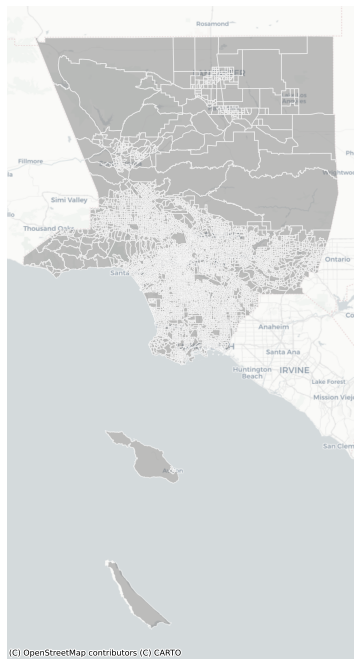

In [6]:
# plot it!
ax=gdf.plot(figsize=(12,12),
                      color='gray', 
                      edgecolor='white',
                      alpha=0.5)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

## Get Arrest Data from LA Open Data Portal
Next, we acquire the data using the socrata API. Use the socrata documentation to grab the code syntax for our arrests data.
- https://dev.socrata.com/foundry/data.lacity.org/amvf-fr72

In [7]:
# connect to the data portal
client = Socrata("data.lacity.org", None)

results = client.get("amvf-fr72", 
                     limit=50000,
                     where = "arst_date between '2020-03-01T00:00:00' and '2020-10-30T00:00:00'",
                     order='arst_date desc')

# Convert to pandas DataFrame
arrests = pd.DataFrame.from_records(results)


In [8]:
arrests.shape

(36216, 25)

### Convert data to a geodataframe

Geopandas allows us to convert different types of data into a spatial format.
- https://geopandas.org/gallery/create_geopandas_from_pandas.html

In [9]:
# convert pandas dataframe to geodataframe
arrests = gpd.GeoDataFrame(arrests, 
                         crs='EPSG:4326',
                         geometry=gpd.points_from_xy(arrests.lon, arrests.lat))

In [10]:
# get the layers into a web mercator projection
# reproject to web mercator
arrests = arrests.to_crs(epsg=3857)

In [11]:
# convert lat/lon to floats
arrests.lon = arrests.lon.astype('float')
arrests.lat = arrests.lat.astype('float')

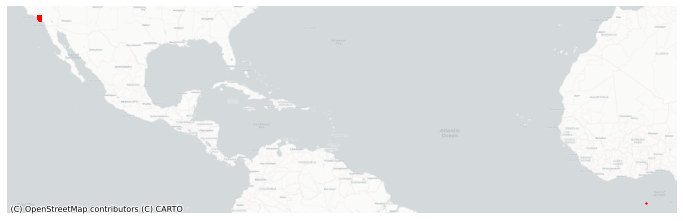

In [12]:
# map it!
ax = arrests.plot(figsize=(12,12),
                  color='red',
                  markersize=1)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)


### The 0,0 conundrum
What is that red dot off the coast of Africa? Yes, that is the infamous spatial black hole, the [0,0] coordinate. There can be many reasons why those red dots get lost and find themselves there. No data may default to 0's, null values may be converted to 0's, or a human may have inadvertently entered 0's for unknown locations. Either which way, since these records do not have valid locations, they need to be deleted from our dataframe in order to proceed.

In [13]:
# subset the zero coordinate records
arrests[arrests.lon==0]

,rpt_id,report_type,arst_date,time,area,area_desc,rd,age,sex_cd,descent_cd,...,location,lat,lon,location_1,bkg_date,bkg_time,bgk_location,bkg_loc_cd,crsst,geometry
18173,5951250,BOOKING,2020-06-09T00:00:00.000,0025,06,Hollywood,0665,39,M,O,...,FOUNTAIN,0.0,0.0,"{'type': 'Point', 'coordinates': [0, 0]}",2020-06-09T00:00:00.000,0224,HOLLYWOOD,4206,MACCADEN,POINT (0.00000 0.00000)
26039,5921308,BOOKING,2020-04-26T00:00:00.000,1500,19,Mission,1942,25,M,H,...,REGAN FY,0.0,0.0,"{'type': 'Point', 'coordinates': [0, 0]}",2020-04-26T00:00:00.000,1631,VALLEY - JAIL DIV,4279,LAUREL CANYON BL,POINT (0.00000 0.00000)


In [14]:
# drop the unmapped rows
arrests.drop(arrests[arrests.lon==0].index,inplace=True)

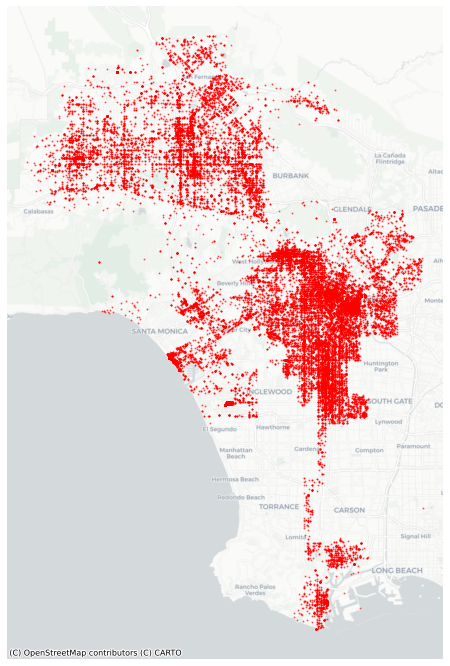

In [15]:
# map it again
ax = arrests.plot(figsize=(12,12),
                  color='red',
                  markersize=1,
                  alpha=0.5)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

## Create a two layer map

- https://geopandas.org/mapping.html

Since we want to zoom to the extent of the arrests layer (and not the block groups), get the bounding coordinates for our axis.

In [16]:
# get the bounding box coordinates for the arrest data
minx, miny, maxx, maxy = arrests.geometry.total_bounds
print(minx)
print(maxx)
print(miny)
print(maxy)

-13209059.458039049
-13153388.580693332
3989526.8110836204
4072889.465652517


## Subplots for multi-layered maps

For our multi-layered maps, we are taking it one step further from our previous lab using matplotlib's `subplots`. `subplots` allows the creation of multiple plots on a gridded canvas. For our map, we only need a single subplot, but we are layered multiple datasets *on top of one another* on that subplot. To specify which subplot to put the layer on, you use the `ax` argument.

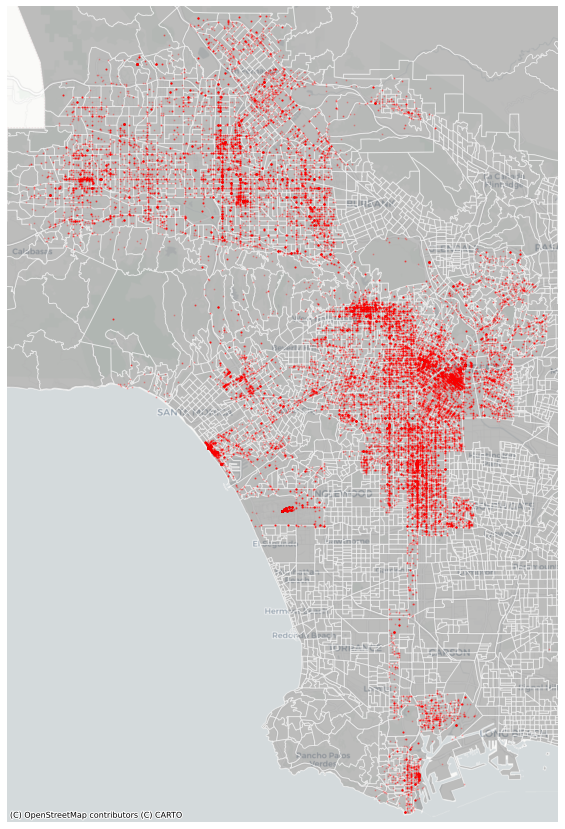

In [17]:
# set up the plot canvas with plt.subplots
fig, ax = plt.subplots(figsize=(15, 15))

# block groups
gdf.plot(ax=ax, # this puts it in the ax plot
        color='gray', 
        edgecolor='white',
        alpha=0.5)

# arrests
arrests.plot(ax=ax, # this also puts it in the same ax plot
            color='red',
            markersize=1,
            alpha=0.2)

# use the bounding box coordinates to set the x and y limits
ax.set_xlim(minx - 1000, maxx + 1000) # added/substracted value is to give some margin around total bounds
ax.set_ylim(miny - 1000, maxy + 1000)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

## The spatial join

* https://geopandas.org/mergingdata.html?highlight=spatial%20join

In a Spatial Join, two geometry objects are merged based on their spatial relationship to one another.

The how argument specifies the type of join that will occur and which geometry is retained in the resultant geodataframe. It accepts the following options:

`left`: use the index from the first (or left_df) geodataframe that you provide to sjoin; retain only the left_df geometry column

`right`: use index from second (or right_df); retain only the right_df geometry column

`inner`: use intersection of index values from both geodataframes; retain only the left_df geometry column



While the official documentation may seem confusing, consider the following as a rule of thumb. When you do a spatial join with `gpd.sjoin()`, you feed it three arguments: a left dataframe, a right dataframe, and a how statement.

- **Left dataframe**: identify the layer that you want to get information *from* to attach to the other layer
- **Right dataframe**: identify the layer you want *to* attach infomation that will come from the other layer

Once you identify your left and right dataframes, use `how="right"` to spatially join the two layers (think: "I'm sending data from the left to the right"). Note that this will result in a dataframe with the same number of rows as the RIGHT layer.

In [18]:
# Do the spatial join
join = gpd.sjoin(gdf, arrests, how='right')

This created a dataframe that has every arrest record with the corresponding FIPS code.

Next, we create another dataframe that counts crime by their corresponding block group:

In [19]:
arrests_by_gdf = join.FIPS.value_counts().rename_axis('FIPS').reset_index(name='arrests_count')

In [20]:
arrests_by_gdf.head()

,FIPS,arrests_count
0,060379800281,709
1,060372088011,310
2,060372077101,286
3,060372063003,245
4,060371907001,233


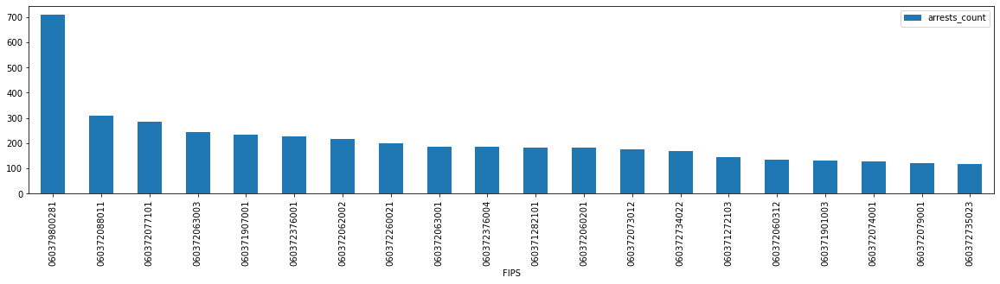

In [21]:
# make a bar chart of top 20 geographies
arrests_by_gdf[:20].plot.bar(figsize=(20,4),
                             x='FIPS',
                             y='arrests_count')

## Join the value counts back to the gdf

How many people know their census block number? The bar chart is nice, but it is not informative at all. Without spatial awareness, the data chart does little to convey knowledge. What we want is a choropleth map to accompany it. To do so, we merge the counts back to the block group gdf.

In [22]:
# join the summary table back to the gdf
gdf=gdf.merge(arrests_by_gdf,on='FIPS')

Now the block group gdf has a new column for arrest counts:

In [23]:
# our neighborhood table now has a count column
gdf.head()

,FIPS,geometry,arrests_count
0,060372932023,"POLYGON ((-13168995.036 4004624.033, -13169004...",13
1,060372941201,"POLYGON ((-13163082.634 4001985.500, -13163084...",4
2,060372932022,"POLYGON ((-13168993.812 4004966.790, -13169017...",3
3,060372932021,"POLYGON ((-13169006.391 4005421.849, -13169028...",2
4,060372941101,"POLYGON ((-13164471.234 4001904.320, -13164369...",2


And if you are curious, we can map a slice of the data. Here, we sort the values by descending arrest counts, and only show a slice of the data, the top 20 geographies using the handy `[:20]`.

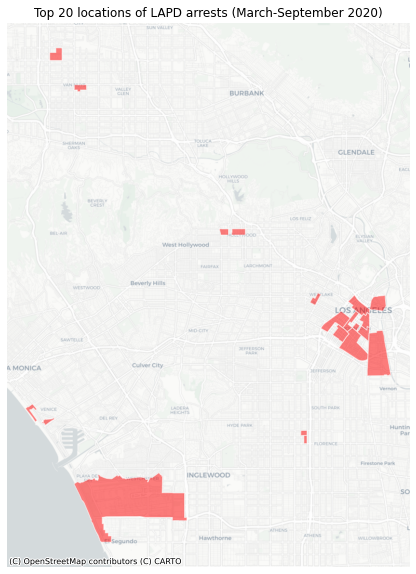

In [24]:
# map the top 20 geographies
ax = gdf.sort_values(by='arrests_count',ascending=False)[:20].plot(figsize=(12,10),
                                                             color='red',
                                                             edgecolor='white',
                                                             alpha=0.5,legend=True)


# title
ax.set_title('Top 20 locations of LAPD arrests (March-September 2020)')

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

## Choropleth map of arrests

Finally, we are ready to generate a choropleth map of arrests. 

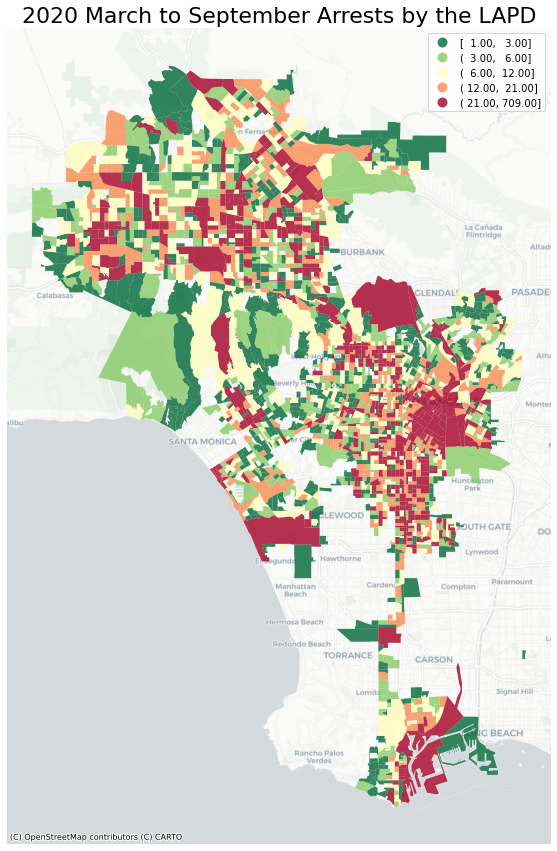

In [25]:
ax = gdf.plot(figsize=(15,15),
                        column='arrests_count',
                        legend=True,
                        alpha=0.8,
                        cmap='RdYlGn_r',
                        scheme='quantiles')

ax.axis('off')
ax.set_title('2020 March to September Arrests by the LAPD',fontsize=22)
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

<div class="alert alert-info">
The map above is a good way to begin exploring spatial patterns in our data. What does this map tell you? Is it informative? Do you notice any significant clusters? What if you change the map? Notice the `scheme` argument is set to `naturalbreaks`. Experiment with other map classfications such as `equalinterval`, `quantiles`. How does each classification change the map? 
</div>

# Global Moran's I
We have imported two datasets. Cleaned them up, spatialized them, and connected them spatially. We successfully mapped them to show the location of arrests by census blocks. The resulting map intuitively and visually tells us that there does appear to be spatial clusters of where arrests are more prevalent, but to what degree of certainty can we say so? Actually, very little, without statitistically backing up our determinations. Could this exact pattern be a matter of chance? Or is the pattern so distinct that there is no way it could have happened randomly?

In order to answer this question, we conduct spatial autocorrelation, a process that determines to what degree an existing pattern is or is not random.

Global Moran's I statistic is a way to *quantify* the degree to which similar geographies are clustered. To do so, we compare each geography based on a given value (in this case arrest counts) with that of its neighbors. The first step of this process is to define a "spatial weight." 

### Spatial Weights
Spatial weights are how we determine the area’s neighborhood. There are different statistical methods that are used for determining spatial weights. Some use a contiguity model, assigning neighbors based on boundaries that touch each other. Others are based on distance, finding the closest neighbors based on the centroid of each geography. So which method should we use? The City of Los Angeles has an unusual shape. Case in point:why does it have the long narrow tail that leads to Long Beach?

<img src="https://lavenuesproject.files.wordpress.com/2015/02/detail-homer-hamlin-map-from-loc.jpg" width=400>

[Source: LA Venues Project](https://lavenuesproject.com/2015/02/01/the-shoestring-strip-los-angeles-goes-out-on-a-limb/)

For this lab, we will use the KNN weight, where `k` is the number of "nearest neighbors" to count in the calculations. Let's proceed with `k=8` for our KNN spatial weights.

- https://geographicdata.science/book/notebooks/04_spatial_weights.html#distance-based-weights


In [26]:
# calculate spatial weight
wq =  lps.weights.KNN.from_dataframe(gdf,k=8)
wq.transform = 'r'

### Spatial lag

Now that we have our spatial weights assigned, we use it to calculate the spatial lag. While the mathematical operations are beyond the scope of this lab, you are welcome to check it out [here](https://geographicdata.science/book/notebooks/06_spatial_autocorrelation.html#spatial-lag). Simply put, the spatial lag is a calculated assignment to each geography in your data, which takes into account the data values from others in their  "neighborhood" as defined by the spatial weight. This operation can be done with a single line of code which is part of the pysal module, but the underlying calculations are not that difficult to understand: it takes the average of all the neighbors as defined by the spatial weight to come up with a single associated value.

In [27]:
# create a new column for the spatial lag
gdf['arrests_count_lag'] = lps.weights.lag_spatial(wq, gdf['arrests_count'])

In [28]:
gdf.sort_values(by='arrests_count',ascending=False).head()

,FIPS,geometry,arrests_count,arrests_count_lag
1058,060379800281,"POLYGON ((-13178640.094 4022802.672, -13178707...",709,6.000
533,060372088011,"POLYGON ((-13166054.534 4037260.611, -13166082...",310,33.375
2308,060372077101,"POLYGON ((-13163728.847 4035353.985, -13163847...",286,58.500
2312,060372063003,"POLYGON ((-13162972.653 4034790.390, -13163045...",245,109.750
694,060371907001,"POLYGON ((-13172064.340 4041968.481, -13172065...",233,41.500


### The diamond and the donut

In order to better understand the significance of the spatial lag values, consider the following two geographies:

In [29]:
gdf[gdf['FIPS'].isin(['060379800281', '060372073011'])]

,FIPS,geometry,arrests_count,arrests_count_lag
747,060372073011,"POLYGON ((-13163638.344 4034975.117, -13163709...",15,113.375
1058,060379800281,"POLYGON ((-13178640.094 4022802.672, -13178707...",709,6.000


The first row, FIPS code `060379800281` is the census block that represents LAX. It is *the* outlier of our data, recording 709 arrests where the median is a paltry 8 arrests based on 2410 records. It's spatial lag? Just 6.

The second row, FIPS code `060372062001` is located in the heart of downtown with an arrest count of 15. It's spatial lag? 113! 

What these numbers tell us is that LAX is a diamond in the rough. A super high valued geography surrounded by super low values. Contrast that with the downtown block, which is more like a donut. An average geography surrounded by super high valued neighbors. It's like a rent-controlled unit in a gentrified community!

To better illustrate our discovery, let's display these locations using satellite imagery. To do so, we use Plotly Express and its Mapbox Satellite basemap (which provides high quality and up to date imagery). Note that the use of Mapbox satellite image tiles require a user token. 

In [30]:
# set the mapbox access token
token = 'pk.eyJ1IjoieW9obWFuIiwiYSI6IkxuRThfNFkifQ.u2xRJMiChx914U7mOZMiZw'
px.set_mapbox_access_token(token)

In [31]:
# subset lax, project to WGS84, and get its centroid
gdf_lax = gdf[gdf.FIPS=='060379800281']
gdf_lax = gdf_lax.to_crs('epsg:4326')

# what's the centroid?
minx, miny, maxx, maxy = gdf_lax.geometry.total_bounds
center_lat_lax = (maxy-miny)/2+miny
center_lon_lax = (maxx-minx)/2+minx

In [32]:
# subset downtown, project to WGS84, and get its centroid
gdf_downtown = gdf[gdf.FIPS=='060372073011']
gdf_downtown = gdf_downtown.to_crs('epsg:4326')

# what's the centroid?
minx, miny, maxx, maxy = gdf_downtown.geometry.total_bounds
center_lat_downtown = (maxy-miny)/2+miny
center_lon_downtown = (maxx-minx)/2+minx

In [33]:
px.choropleth_mapbox(gdf_lax, 
                     geojson=gdf_lax.geometry, 
                     locations=gdf_lax.index, 
                     mapbox_style="satellite-streets",
                     zoom=12, center = {"lat": center_lat_lax, "lon": center_lon_lax},
                     opacity=0.4)

In [34]:
px.choropleth_mapbox(gdf_downtown, 
                     geojson=gdf_downtown.geometry, 
                     locations=gdf_downtown.index, 
                     mapbox_style="satellite-streets",
                     zoom=14, center = {"lat": center_lat_downtown, "lon": center_lon_downtown},
                     opacity=0.4)

## Spatial lag map
But we digress. Let's map the entire dataframe by the newly created spatial lag column.

In [35]:
gdf.head()

,FIPS,geometry,arrests_count,arrests_count_lag
0,060372932023,"POLYGON ((-13168995.036 4004624.033, -13169004...",13,4.125
1,060372941201,"POLYGON ((-13163082.634 4001985.500, -13163084...",4,7.875
2,060372932022,"POLYGON ((-13168993.812 4004966.790, -13169017...",3,5.750
3,060372932021,"POLYGON ((-13169006.391 4005421.849, -13169028...",2,5.875
4,060372941101,"POLYGON ((-13164471.234 4001904.320, -13164369...",2,8.000


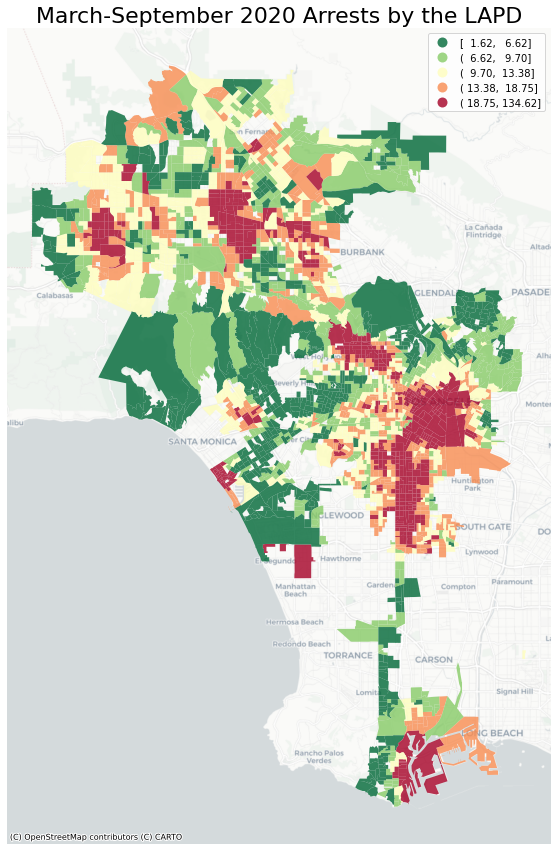

In [36]:
# use subplots that make it easier to create multiple layered maps
fig, ax = plt.subplots(figsize=(15, 15))

# spatial lag choropleth
gdf.plot(ax=ax,
         figsize=(15,15),
         column='arrests_count_lag',
         legend=True,
         alpha=0.8,
         cmap='RdYlGn_r',
         scheme='quantiles')

# uncomment this to see the actual point locations of arrests
# arrests.plot(ax=ax, 
#              color='blue',
#              markersize =1,
#              alpha=0.2, 
#              legend=True)

ax.axis('off')
ax.set_title('March-September 2020 Arrests by the LAPD',fontsize=22)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

## Interactive spatial lag map
Buidling the equivalent map as an interactive javascript map is a bit more challenging. While there are several options to choose from, this lab will use plotly express's choropleth_mapbox feature.
- https://plotly.com/python/mapbox-county-choropleth/#

In [70]:
# interactive version needs to be in WGS84
gdf_web = gdf.to_crs('EPSG:4326')

In [60]:
# what's the centroid?
minx, miny, maxx, maxy = gdf_lax.geometry.total_bounds
center_lat_gdf_web = (maxy-miny)/2+miny
center_lon_gdf_web = (maxx-minx)/2+minx

Unlike the matplotlib map, plotly's mapbox map only gives us a continuous scale option. To produce a similar quantile map, we need to calculate the values manually.

In [71]:
# grab the median
median = gdf_web.arrests_count_lag.median()

In [72]:
fig = px.choropleth_mapbox(gdf_web, 
                     geojson=gdf_web.geometry, 
                     locations=gdf_web.index, 
                     mapbox_style="satellite-streets",
                     zoom=8, 
                     color='arrests_count_lag',
                     color_continuous_scale='RdYlGn_r',
                     color_continuous_midpoint =median,
                     range_color =(0,median*2),
                     center = {"lat": center_lat_gdf_web, "lon": center_lon_gdf_web},
                     opacity=0.8)
fig.update_traces(marker_line_width=0)

We can now compare these two map outputs side by side. Notice that the syntax is a bit different from past labs where we have only worked with one figure at a time. This output produces 1 row, and 2 columns of figures in `subplots`.
- [subplots documentation](https://matplotlib.org/3.3.0/gallery/subplots_axes_and_figures/subplots_demo.html)

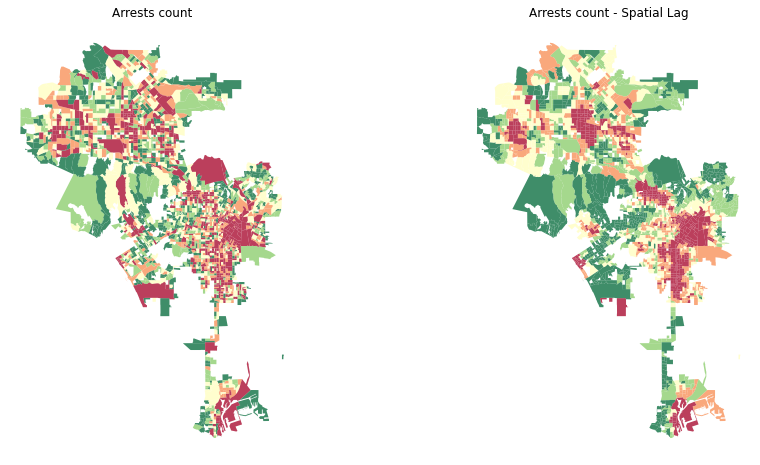

In [37]:
# create the 1x2 subplots
fig, axs = plt.subplots(1, 2, figsize=(15, 8))

# name each subplot
ax1, ax2 = axs

# regular count map on the left
gdf.plot(column='arrests_count', 
            cmap='RdYlGn_r', 
            scheme='quantiles',
            k=5, 
            edgecolor='white', 
            linewidth=0., 
            alpha=0.75, 
#             legend=True, 
            ax=ax1 # this assigns the map to the subplot
           )


ax1.axis("off")
ax1.set_title("Arrests count")

# spatial lag map on the right
gdf.plot(column='arrests_count_lag', 
            cmap='RdYlGn_r', 
            scheme='quantiles',
            k=5, 
            edgecolor='white', 
            linewidth=0., 
            alpha=0.75, 
#             legend=True, 
            ax=ax2 # this assigns the map to the subplot
           )

ax2.axis("off")
ax2.set_title("Arrests count - Spatial Lag")

plt.show()

## Moran's Plot

We now have a spatial lag map: a map that displays geographies weighted against the values of its neighbors. The clusters are much clearer and cleaner than the original arrest count map. Downtown, South LA,  But we still have not *quantified* the degree of the spatial correlations. To begin this process, we test for global autocorrelation for a continuous attribute (arrest counts).

In [76]:
y = gdf.arrests_count
moran = Moran(y, wq)
moran.I

0.22100924434272579

The moran's I value is nothing more than the calculated slope of the scatterplot of our arrests and arrests spatial lag columns. You can output a scatterplot:

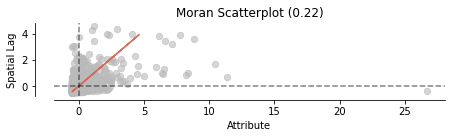

In [74]:
fig, ax = moran_scatterplot(moran, aspect_equal=True)
plt.show()

Thanks to the splot visualisation module in PySAL, we can obtain a quick representation of the statistic that combines the Moran Plot (right) with a graphic of the empirical test that we carry out to obtain p_sim (left):

(<Figure size 720x288 with 2 Axes>,
 array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f89d5945130>,
       dtype=object))

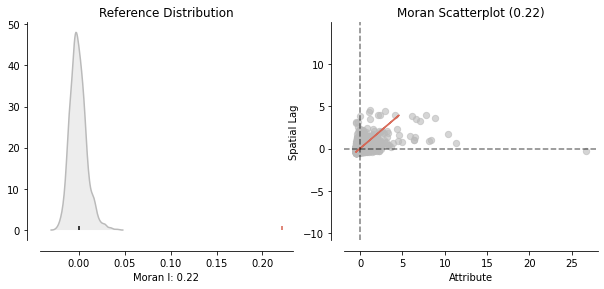

In [39]:
plot_moran(moran)

The other bit of information we will extract from Moran’s I relates to statistical inference: how likely is the pattern we observe in the map and Moran’s I captures in its value to be generated by an entirely random process? If we considered the same variable but shuffled its locations randomly, would we obtain a map with similar characteristics? To obtain insight into these questions, PySAL performs a simulation and returns a measure of certainty about how likely it is the pattern we observe in our dataset came from a spatially random process. This is summarised in the p_sim attribute:

In [41]:
moran.p_sim

0.001

The value is calculated as an empirical P-value that represents the proportion of realisations in the simulation under spatial randomness that are more extreme than the observed value. A small enough p-value associated with the Moran’s I of a map allows to reject the hypothesis that the map is random. In other words, we can conclude that the map displays more spatial pattern than we would expect if the values had been randomly allocated to a locations.

That is a very low value, particularly considering it is actually the minimum value we could have obtained given the simulation behind it used 999 permutations (default in PySAL) and, by standard terms, it would be deemed statistically significant. We can ellaborate a bit further on the intuition behind the value of p_sim. If we generated a large number of maps with the same values but randomly allocated over space, and calculated the Moran’s I statistic for each of those maps, only 0.01% of them would display a larger (absolute) value than the one we obtain from the observed data, and the other 99.99% of the random maps would receive a smaller (absolute) value of Moran’s I. If we remember again that the value of Moran’s I can also be interpreted as the slope of the Moran Plot, what we have is that, in this case, the particular spatial arrangement of values over space we observe for the number of arrest counts is more concentrated than if we were to randomly shuffle the arrest numbers among the map, hence the statistical significance. As a first step, the global autocorrelation analysis can teach us that observations do seem to be positively autocorrelated over space. 

## Local autocorrelation

In [43]:
lisa = esda.moran.Moran_Local(y, wq)

- https://pysal.org/esda/generated/esda.Moran_Local.html

In [44]:
# how many per quadrant?
counts = [(j,(lisa.q==j).sum()) for j in range(1,5)]
counts

[(1, 400), (2, 355), (3, 1347), (4, 308)]

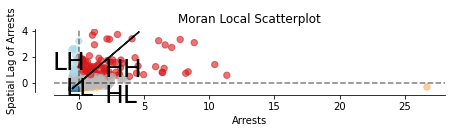

In [45]:
# Plot
fig, ax = moran_scatterplot(lisa, p=0.05)
ax.set_xlabel("Arrests")
ax.set_ylabel('Spatial Lag of Arrests')
plt.text(1.95, 0.5, "HH", fontsize=25)
plt.text(1.95, -1.5, "HL", fontsize=25)
plt.text(-2, 1, "LH", fontsize=25)
plt.text(-1, -1, "LL", fontsize=25)
plt.show()

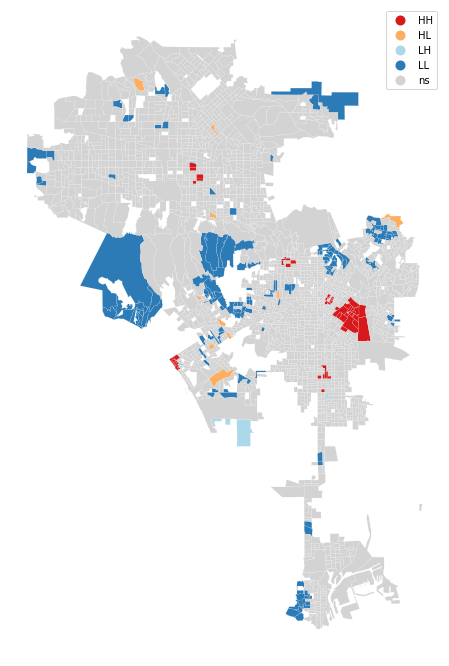

In [46]:
fig, ax = plt.subplots(figsize=(14,12))
lisa_cluster(lisa, gdf, p=0.01, figsize = (16,12),ax=ax)
plt.show()

## Identifying significant rows

The correspondence between the numbers in the q attribute and the actual quadrants is as follows:

1: HH

2: LH

3: LL

4: HL

In [47]:
# original df... how many rows?
len(gdf)

2410

In [48]:
# original value list
lisa.y[:5]

array([13,  4,  3,  2,  2])

In [49]:
# quadrant list
lisa.q[:5]

array([3, 3, 3, 3, 3])

In [50]:
# p sim list
lisa.p_sim[:5]

array([0.003, 0.132, 0.027, 0.027, 0.132])

In [51]:
# add it to the dataframe
gdf['q'] = lisa.q.tolist()

In [52]:
# add it to the dataframe
gdf['p_sim'] = lisa.p_sim.tolist()

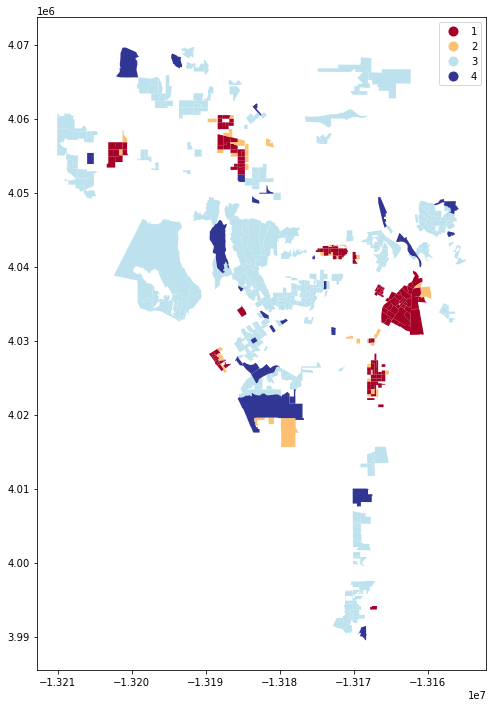

In [53]:
gdf[gdf.p_sim < 0.05].plot(figsize=(12,12),column='q',legend=True,categorical=True,cmap='RdYlBu')

# Resources

- https://geographicdata.science/book/notebooks/06_spatial_autocorrelation.html
- https://pysal.org/esda/notebooks/spatialautocorrelation.html
- https://towardsdatascience.com/what-is-exploratory-spatial-data-analysis-esda-335da79026ee